In [1]:
# using Pkg
# Pkg.add("WAV")
using Plots
using FFTW

### Zadanie 1

In [2]:
Fs = 1024;  
t = 0:1/(Fs-1):1; 

x = sin.(2*pi*t*200) + 2* sin.(2*pi*t*400) 

1024-element Vector{Float64}:
  0.0
  2.207021244212628
 -1.3271388898696335
  1.2533964120246632
 -1.762901709938093
 -0.6983641556218964
  2.532063773598228
 -1.258094993652871
  1.0495632085008157
 -1.2371701815227443
 -1.3497121474756428
  2.70889209238244
 -1.045639160072822
  ⋮
 -2.708892092382448
  1.3497121474756923
  1.2371701815226994
 -1.0495632085007944
  1.2580949936528594
 -2.5320637735982467
  0.698364155621943
  1.7629017099380595
 -1.253396412024654
  1.3271388898696337
 -2.207021244212651
  3.928773447456944e-14

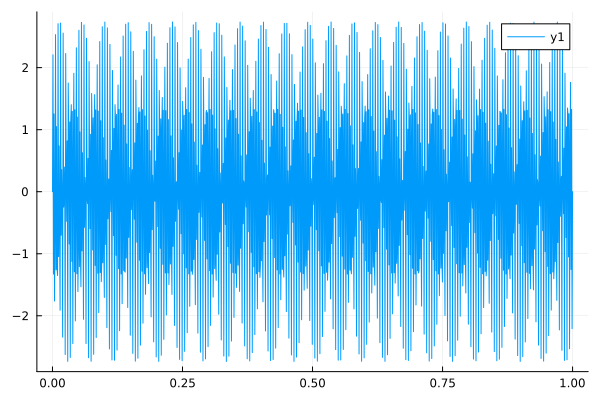

In [3]:
plot(t,x)

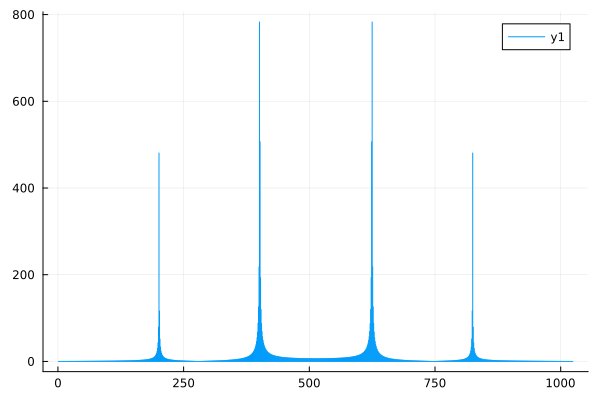

In [4]:
sticks((abs.(fft(x))))

### Zadanie 2

In [23]:
Fs = 1024;  

t = 0:1/(Fs-1):1; 

rands = [rand() / 5 for _ in t]
x = cos.(2*pi*t*50) + rands

1024-element Vector{Float64}:
  1.179376008891988
  0.9867069966995445
  0.8270307983799207
  0.6605314004189052
  0.3484732746050866
  0.217162518294591
 -0.1668824900697733
 -0.36367100834080945
 -0.7117460586996869
 -0.7847395917106946
 -0.9529464571253792
 -0.9663539625599068
 -0.7485494058768827
  ⋮
 -0.9217118597169587
 -0.8118224328578912
 -0.7918003636389747
 -0.6543798259127529
 -0.5307950534217459
 -0.20081740759299938
  0.1032698623637579
  0.4074478582784504
  0.6733893296619491
  0.8982009048124687
  1.1135266060985736
  1.1575450044908937

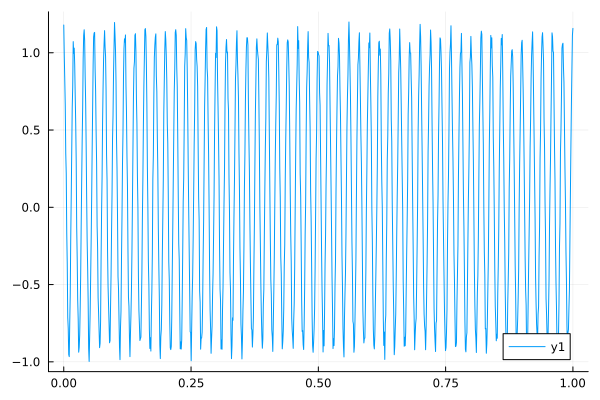

In [24]:
plot(t, x)

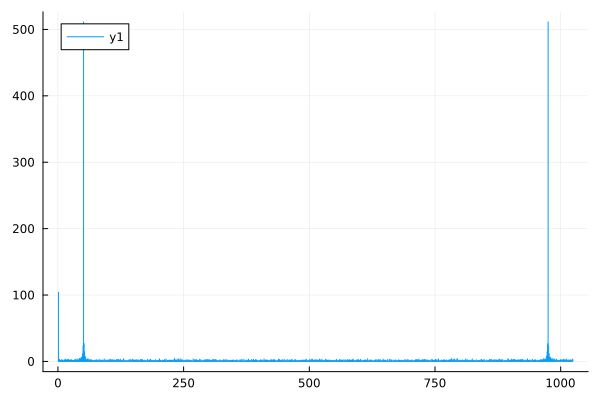

In [25]:
sticks((abs.(fft(x))))

In [26]:
fftx = fft(x)
fftx[abs.(fftx) .< 50] .= 0

1021-element view(::Vector{ComplexF64}, [2, 3, 4, 5, 6, 7, 8, 9, 10, 11  …  1015, 1016, 1017, 1018, 1019, 1020, 1021, 1022, 1023, 1024]) with eltype ComplexF64:
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
     ⋮
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im
 0.0 + 0.0im

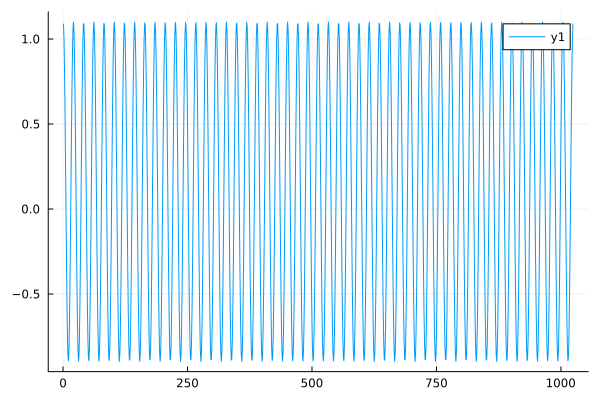

In [27]:
x1 = ifft(fftx)
plot(real.(x1))

### Zadanie 3

In [10]:
using WAV

In [127]:
sound, prob_freq = wavread("ooo.wav")

([0.0 0.0; 3.051850947599719e-5 3.051850947599719e-5; … ; -3.051850947599719e-5 -3.051850947599719e-5; -3.051850947599719e-5 -3.051850947599719e-5], 48000.0f0, 0x0010, WAVChunk[WAVChunk(Symbol("fmt "), UInt8[0x10, 0x00, 0x00, 0x00, 0x01, 0x00, 0x02, 0x00, 0x80, 0xbb, 0x00, 0x00, 0x00, 0xee, 0x02, 0x00, 0x04, 0x00, 0x10, 0x00]), WAVChunk(:LIST, UInt8[0x49, 0x4e, 0x46, 0x4f, 0x49, 0x43, 0x52, 0x44, 0x05, 0x00  …  0x35, 0x39, 0x2e, 0x32, 0x37, 0x2e, 0x31, 0x30, 0x30, 0x00])])

In [128]:
size(sound)

(171008, 2)

In [129]:
prob_freq

48000.0f0

In [130]:
size(sound)[1] / prob_freq

3.5626667f0

In [131]:
sound_compressed = [s for (i, s) in enumerate(sound[:,1]) if i % 10 == 0]

17100-element Vector{Float64}:
  0.00018311105685598315
  0.0003662221137119663
  0.00027466658528397473
 -0.0003051850947599719
 -0.0010681478316599017
 -0.0016479995117038484
 -0.00173955504013184
 -0.001281777397991882
 -0.0003662221137119663
  0.000640888698995941
  0.001281777397991882
  0.0010376293221839045
  3.051850947599719e-5
  ⋮
  0.0
  3.051850947599719e-5
  0.0
  0.0
  0.0
 -3.051850947599719e-5
  0.0
  0.0
 -6.103701895199438e-5
  0.0
  3.051850947599719e-5
  3.051850947599719e-5

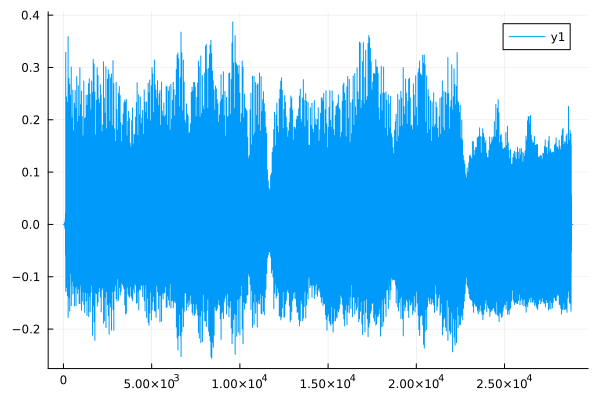

In [71]:
plot(sound_compressed)

In [17]:
wavwrite(sound_compressed, "compressed.wav", Fs=prob_freq/10)

In [132]:
sound0 = sound[:,1]

171008-element Vector{Float64}:
  0.0
  3.051850947599719e-5
  3.051850947599719e-5
  6.103701895199438e-5
  9.155552842799158e-5
  9.155552842799158e-5
  0.00012207403790398877
  0.00015259254737998596
  0.00015259254737998596
  0.00018311105685598315
  0.00021362956633198035
  0.00024414807580797754
  0.00027466658528397473
  ⋮
  3.051850947599719e-5
  0.0
  0.0
  3.051850947599719e-5
  0.0
 -3.051850947599719e-5
 -6.103701895199438e-5
 -6.103701895199438e-5
 -6.103701895199438e-5
 -6.103701895199438e-5
 -3.051850947599719e-5
 -3.051850947599719e-5

In [21]:
ft_compressed = fft(sound_compressed)

28876-element Vector{ComplexF64}:
     0.711569566942349 - 1.6653345369377348e-15im
     0.660726840130895 - 0.38372365950473863im
    0.4907708793181511 - 0.5797996466326514im
   0.10286416728710623 - 0.32035588473759im
  -0.35610755824383045 - 0.6954739517812971im
   -0.2647265420688063 + 0.30878522563653915im
     0.556891504992068 + 0.015401548117999653im
  -0.22740204443841083 - 1.0491471168169593im
    -0.855266185313103 + 0.18878457785548175im
  -0.25726567780681653 + 0.39445159324561097im
   0.13321624152204636 + 0.4022784830167525im
   0.29246656710704144 + 0.0359690413235505im
 -0.043299856727420316 - 0.526172972719471im
                       ⋮
   -0.0432998567274252 + 0.5261729727194715im
     0.292466567107037 - 0.035969041323538065im
   0.13321624152204592 - 0.40227848301674807im
  -0.25726567780681364 - 0.39445159324560386im
   -0.8552661853131007 - 0.18878457785548064im
  -0.22740204443840906 + 1.049147116816962im
    0.5568915049920744 - 0.015401548117998765im
   -0.26

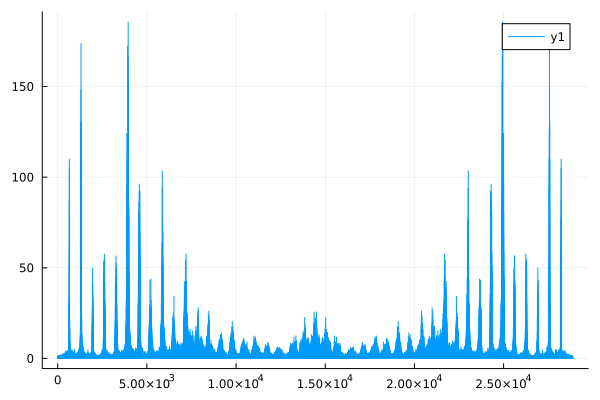

In [22]:
sticks(abs.(ft_compressed))

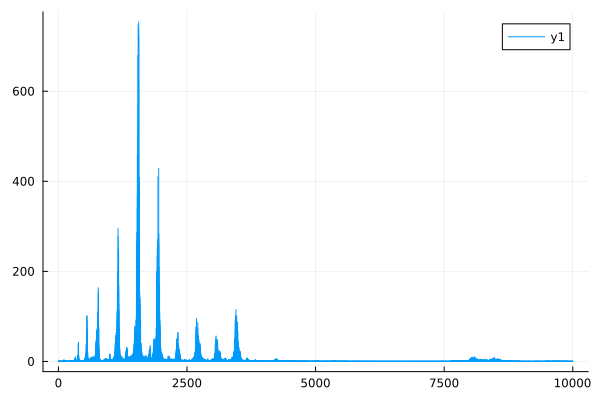

In [133]:
ft = fft(sound0)
sticks(abs.(ft[1:10000]))

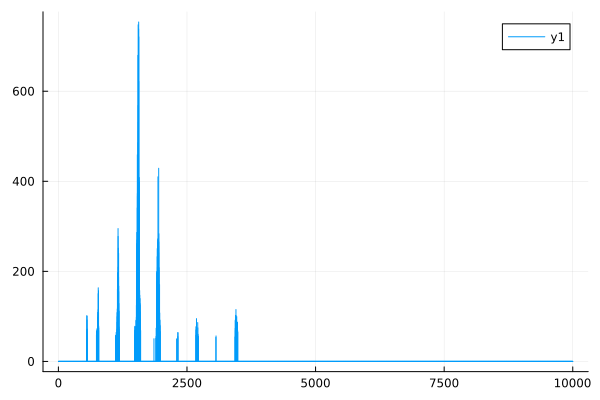

In [134]:
ft[abs.(ft) .< 50] .= 0
sticks(abs.(ft[1:10000]))

In [135]:
sound_clear = ifft(ft)
# plot(real.(sound_clear))

171008-element Vector{ComplexF64}:
 -0.022104723800414106 - 3.490222083402439e-18im
 -0.022128642528424457 - 1.8183568769847455e-18im
 -0.022052537837323763 - 4.699459113634301e-18im
 -0.021873680609123758 + 1.8448692012992808e-18im
 -0.021590100706760127 + 1.2383933817670566e-17im
  -0.02120064178281843 - 1.3256165861357081e-18im
  -0.02070500601580618 + 8.591222793421427e-18im
 -0.020103787889844134 - 1.0873563848430428e-17im
 -0.019398496300604657 + 3.244781252742333e-18im
 -0.018591564450227714 + 6.23442611911961e-19im
  -0.01768634718390796 - 8.389038130517914e-18im
 -0.016687105617801345 - 4.500121439462255e-19im
 -0.015598979108656057 + 3.6365789677009174e-18im
                       ⋮
 -0.015718963108912107 - 1.552756983145519e-18im
 -0.016557949410508636 - 1.4888028129265216e-18im
 -0.017360505192861794 - 1.5527518172820316e-17im
 -0.018121030742084362 + 1.8450356236331156e-19im
 -0.018833708112407904 - 4.566889787014185e-18im
 -0.019492573888064628 - 1.133167842856456e-17im
 

In [136]:
wavwrite(real.(sound_clear), "clearo.wav", Fs=prob_freq)

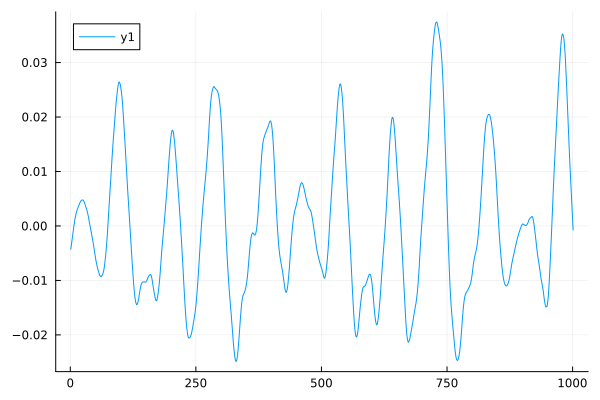

In [137]:
plot(sound0[2000:3000])

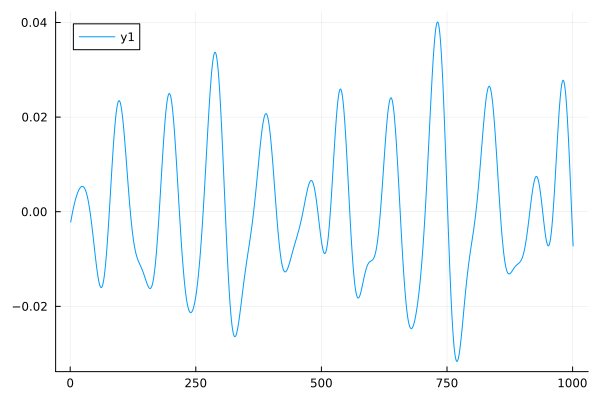

In [138]:
plot(real.(sound_clear)[2000:3000])

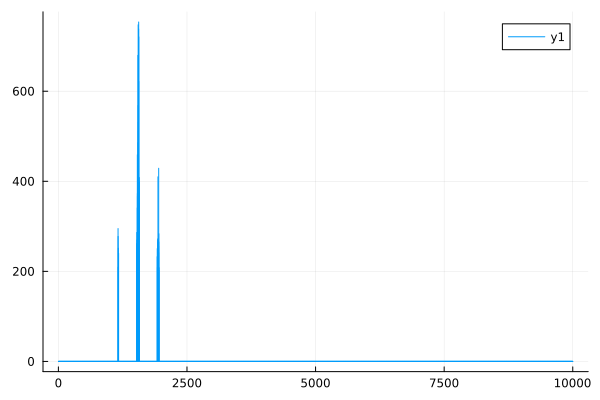

In [147]:
ft1 = fft(sound0)
ft1[abs.(ft1) .< 200] .= 0
# plot_ft = [s for (i, s) in enumerate(abs.(ft1)) if i % 100 == 0]
sticks(abs.(ft1[1:10000]))

In [143]:
x2 = ifft(ft1)
wavwrite(real.(x2), "filtered1o.wav", Fs=prob_freq)

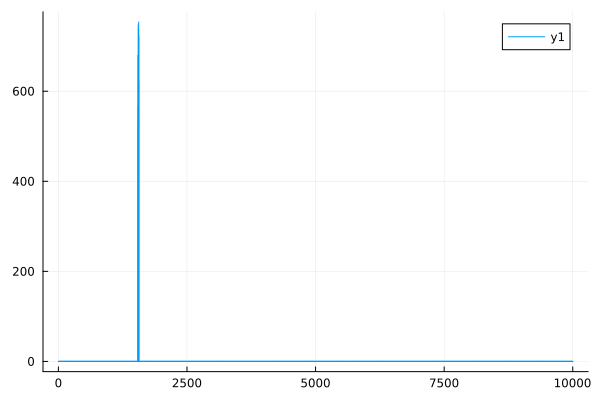

In [148]:
ft1[abs.(ft1) .< 500] .= 0
sticks(abs.(ft1[1:10000]))

In [149]:
x3 = ifft(ft1)
wavwrite(real.(x3), "filtered2o.wav", Fs=prob_freq)

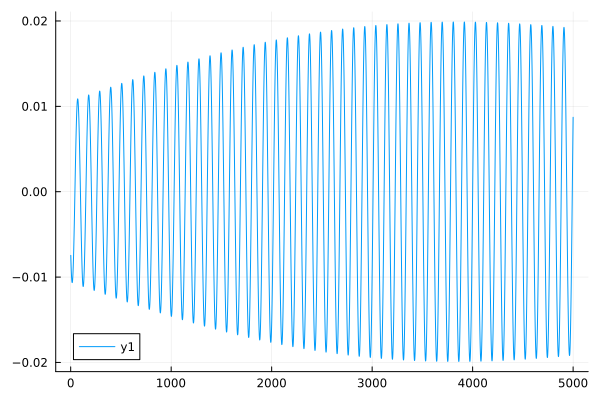

In [150]:
plot(real.(x3)[1:5000])